In [1]:
#이 프로젝트에서 사용할 라이브러리를 모두 임포트 합니다.
!pip install opencv-python
!pip install cvlib

  Created wheel for cvlib: filename=cvlib-0.2.7-py3-none-any.whl size=10046371 sha256=691ec9ee49cb47a0e65abd93b376e5d048f5bd598f6d5606089a0f533bd329cd
  Stored in directory: c:\users\hanjiseok\appdata\local\pip\cache\wheels\bb\11\55\82ced947752cc4056335a4ee9c304a93d43ce857230538f0ae
  Created wheel for imutils: filename=imutils-0.5.4-py3-none-any.whl size=25860 sha256=e59eb9fa5b92bd8935a09c531f09d4e21eb08a3169155829255ca4e532448cfe
  Stored in directory: c:\users\hanjiseok\appdata\local\pip\cache\wheels\59\1b\52\0dea905f8278d5514dc4d0be5e251967f8681670cadd3dca89
  Created wheel for progressbar: filename=progressbar-2.5-py3-none-any.whl size=12075 sha256=d4dfb37d696f8d6c0664651032eda2918333916f7ff475bbe3ae5232b846407f
  Stored in directory: c:\users\hanjiseok\appdata\local\pip\cache\wheels\2c\67\ed\d84123843c937d7e7f5ba88a270d11036473144143355e2747
Successfully built cvlib imutils progressbar


In [1]:
import cv2
import cvlib
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import seaborn as sns
from IPython.display import Image
from sklearn.metrics import confusion_matrix
from tensorflow.keras.preprocessing.image import array_to_img, load_img, img_to_array
from tensorflow.keras.layers import Conv2D, MaxPool2D, Dense, Flatten, Dropout
from tensorflow.keras.layers.experimental.preprocessing import RandomFlip, RandomRotation, RandomCrop
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import load_model

In [6]:
!pip install ipywebrtc

In [7]:
from ipywebrtc import CameraStream, ImageRecorder

In [9]:
import PIL.Image
import PIL.ImageFilter
import io

In [10]:
from ipywidgets import Output, VBox

In [31]:
import os

# in mask 파일 목록 
path = "./photo_in_mask/"
file_list_png_mask = os.listdir(path)
file_list_png_mask = [file for file in file_list_png_mask if file.endswith(".jpg")]
print('in mask 이미지 파일 목록: {0}'.format(file_list_png_mask))
print('in mask 이미지 개수: {0}개'.format(len(file_list_png_mask)))

in mask 이미지 파일 목록: ['0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_007.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_009.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_011.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_013.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_014.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_015.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_017.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_018.jpg', '0827002_REI1_1_1_2D_1_02_1_1_20210827_94718_c161_2097_0_019.jpg', '0827002_SPI_02_1_2D_2_03.jpg', '0827002_SPI_03_1_2D_2_02.jpg', '0827002_SPI_04_1_2D_1_03.jpg', '0827002_SPI_05_1_2D_1_02.jpg', '0827002_SPI_06_1_2D_3_03.jpg', '0827002_SPI_07_1_2D_3_02.jpg', '0827002_SPO_02_1_2D_2_03.jpg', '0827002_SPO_03_1_2D_2_02.jpg', '0827002_SPO_04_1_2D_1_03.jpg', '0827002_SPO_05_1_2D_1_02.jpg', '0827002_SPO_06_1_2D_3_03.jpg', '0827002_SPO_07_1_2D_3_02

In [32]:
# out mask 파일 목록 
path = "./photo_out_mask/"
file_list_png_nonmask = os.listdir(path)
file_list_png_nonmask = [file for file in file_list_png_nonmask if file.endswith(".jpg")]
print('out mask 이미지 파일 목록: {0}'.format(file_list_png_nonmask))
print('out mask 이미지 개수: {0}개'.format(len(file_list_png_nonmask)))

out mask 이미지 파일 목록: ['0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_009.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_012.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_013.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_015.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_016.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_017.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_019.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_021.jpg', '0827002_REI1_1_0_00_0_01_1_1_20210827_94519_c161_2093_0_023.jpg', '0827002_REO1_1_0_00_0_01_1_1_20210827_95235_c171_1864_0_023.jpg', '0827002_REO1_1_0_00_0_01_3_1_20210827_95235_c173_1864_0_015.jpg', '0827002_REO1_1_0_00_0_01_3_1_20210827_95235_c173_1864_0_016.jpg', '0827002_REO1_1_0_00_0_01_3_1_20210827_95235_c173_1864_0_017.jpg', '0827002_REO1_1_0_00_0_01_3_1_20210827_95235_c173_1864_0_018.jpg', '0827002_REO1_1_0_00_0_01_3_1_20210827_95

In [21]:
import time
import cv2
import cvlib
from PIL import Image

def save_facefile(file_list_png, save_path, png_path):
    count = 0
    for png in file_list_png:
        im = Image.open(png_path + png)
        im = im.convert("RGB")
        pimg = np.array(im)

        plt.imshow(pimg)
        plt.show()

        faces, confidences = cvlib.detect_face(pimg)   # 얼굴 탐지하기
        print(faces, confidences)
        for face, confidence in zip(faces, confidences):
            if confidence < 0.5:   # 얼굴일 확률이 50% 이하면 패스한다.
                continue
            start_x, start_y, end_x, end_y = square_crop(face)
            plt.imshow(pimg[start_y:end_y, start_x:end_x, :])
            plt.show()
            try:
                cv2.imwrite(save_path+str(count)+'.jpg', pimg[start_y:end_y, start_x:end_x, :])   # 얼굴만 저장하기 
                count += 1
            except:
                break
                
# 얼굴이 이미지의 가운데에 위치하도록 crop 하되, crop 영역이 정사각형이 되도록 합니다.
def square_crop(faces): 
    start_x, start_y, end_x, end_y = faces
    height, width = end_y - start_y, end_x - start_x
    if width > height: 
        diff = width - height 
        start_y -= diff//2
        end_y += diff//2
    else: 
        diff = height - width
        start_x -= diff//2
        end_x += diff//2
    return start_x, start_y, end_x, end_y

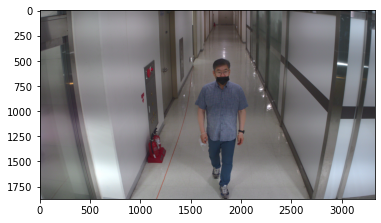

[] []


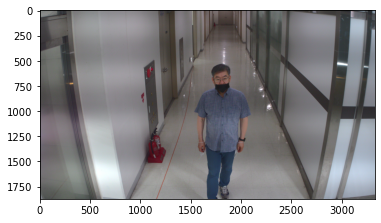

[] []


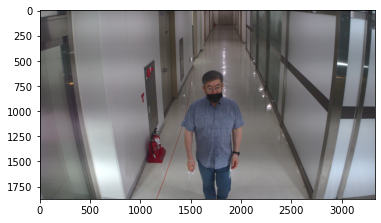

[] []


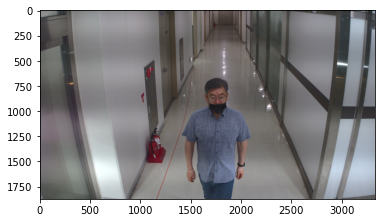

[] []


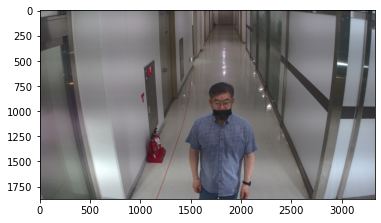

[] []


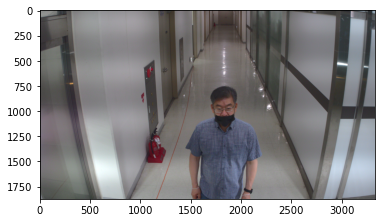

[] []


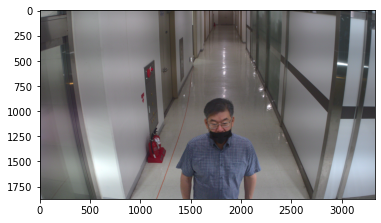

[] []


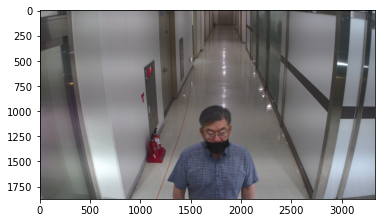

[] []


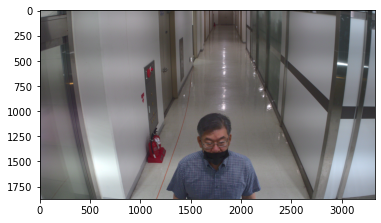

[] []


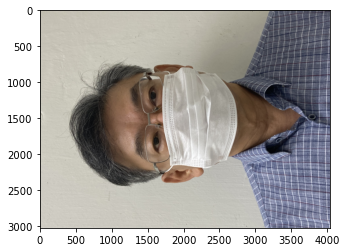

[[945, 860, 1911, 2271]] [0.57383466]


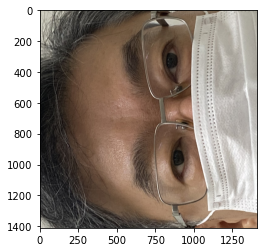

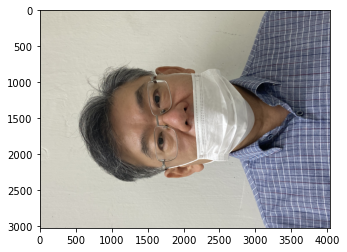

[[1055, 869, 2093, 2190]] [0.79544556]


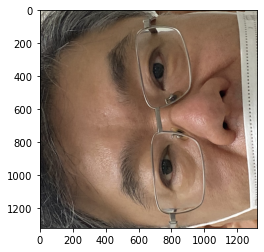

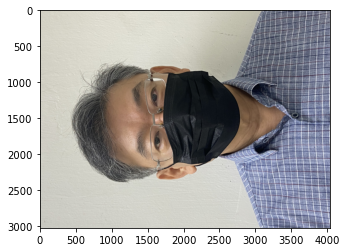

[] []


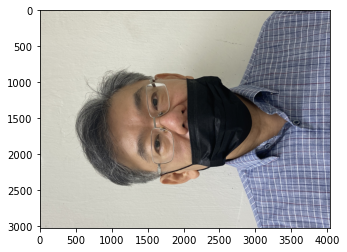

[[1013, 952, 2122, 2307]] [0.8678282]


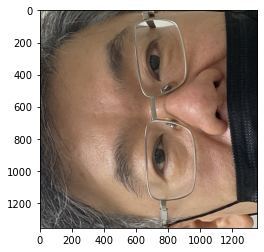

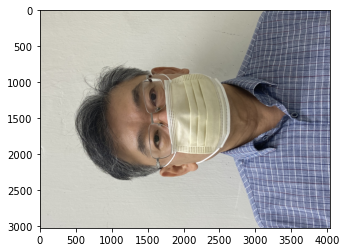

[[985, 880, 2082, 2172]] [0.8186213]


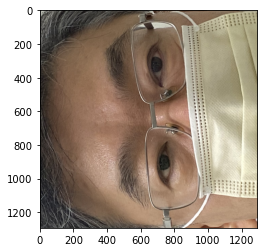

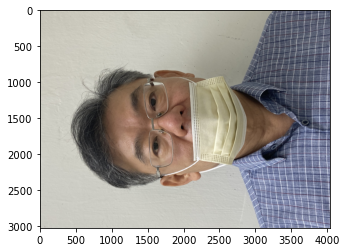

[[945, 876, 2010, 2290]] [0.813884]


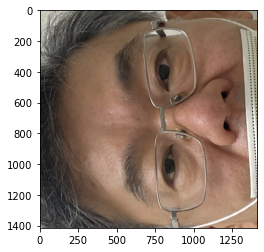

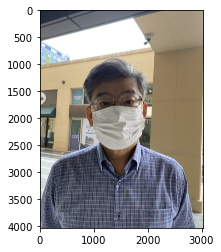

[[862, 1173, 1914, 2513]] [0.9905731]


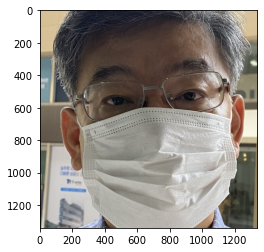

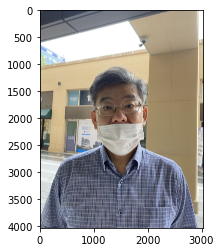

[[996, 1336, 1877, 2556]] [0.8030351]


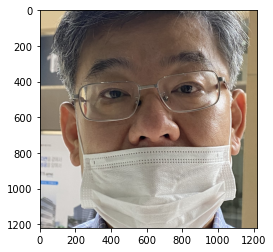

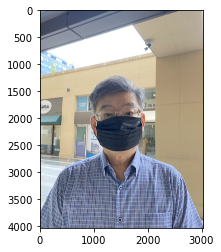

[[1049, 1445, 1894, 2477]] [0.5788263]


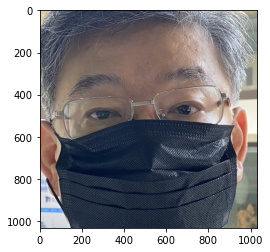

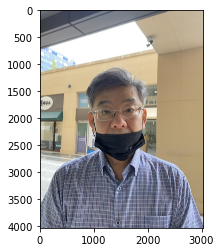

[[952, 1438, 1853, 2514]] [0.9715143]


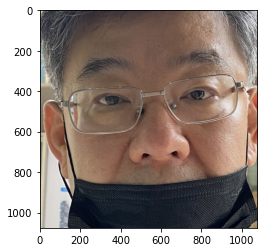

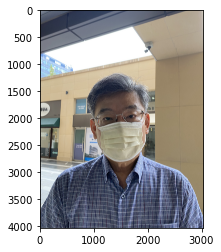

[[940, 1577, 1861, 2717]] [0.8866555]


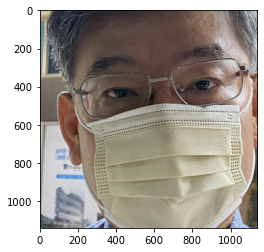

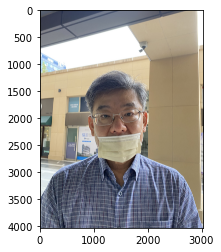

[[929, 1470, 1879, 2637]] [0.9908408]


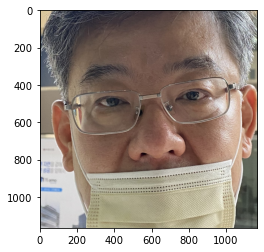

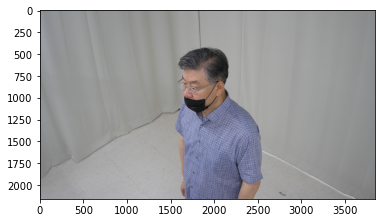

[] []


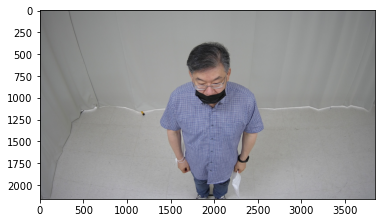

[] []


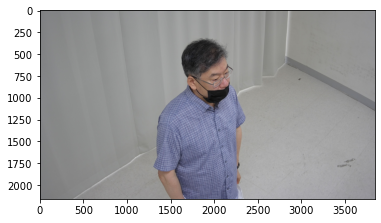

[] []


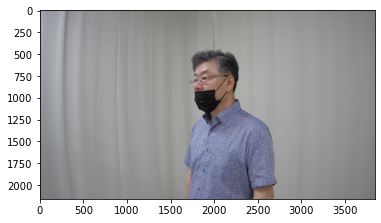

[] []


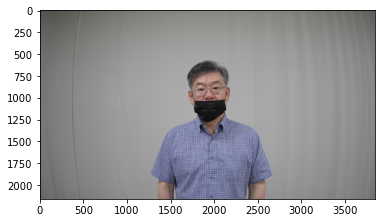

[[1749, 710, 2134, 1243]] [0.59063894]


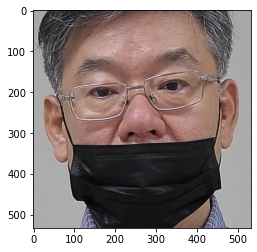

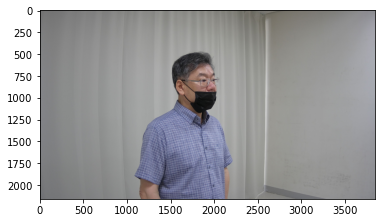

[] []


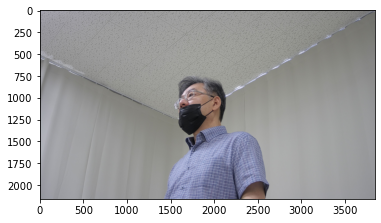

[] []


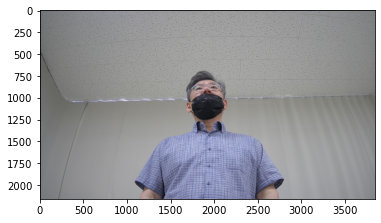

[] []


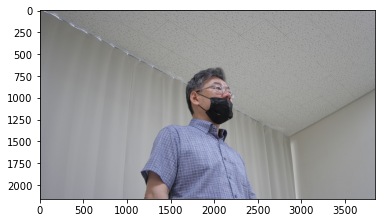

[] []


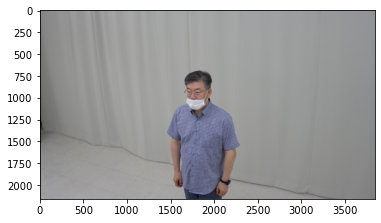

[] []


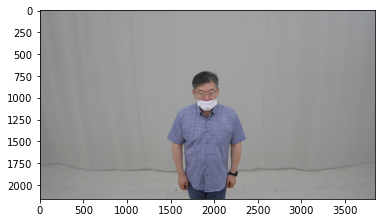

[] []


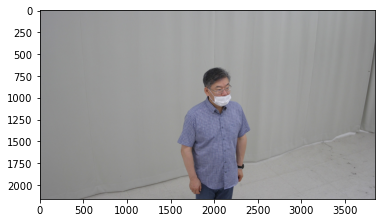

[] []


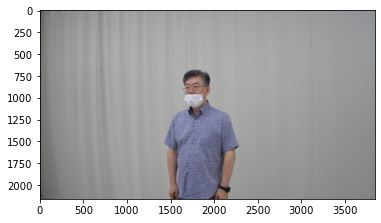

[] []


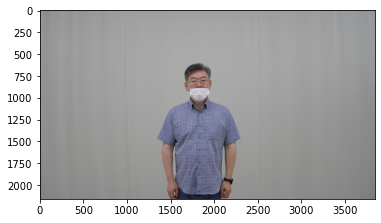

[] []


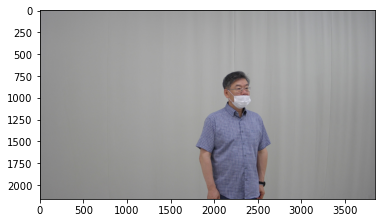

[] []


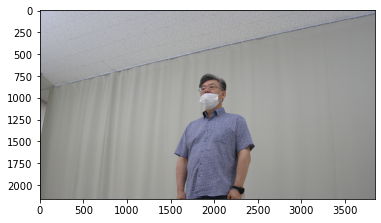

[] []


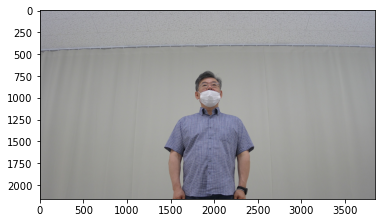

[] []


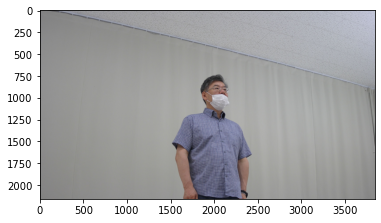

[] []


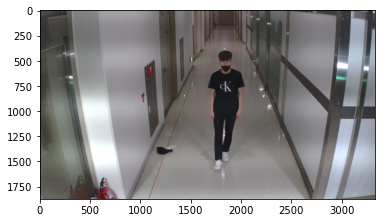

[] []


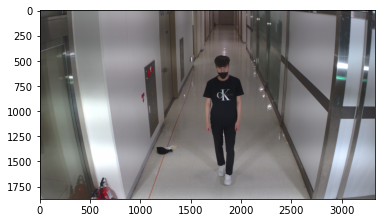

[] []


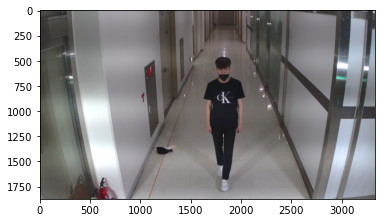

[] []


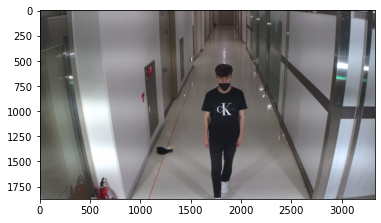

[] []


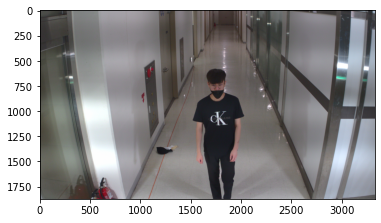

[] []


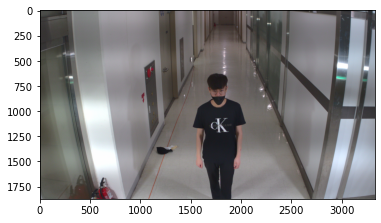

[] []


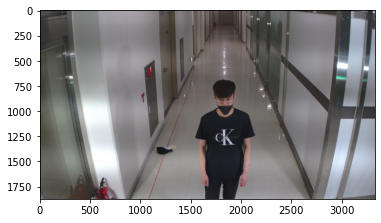

[] []


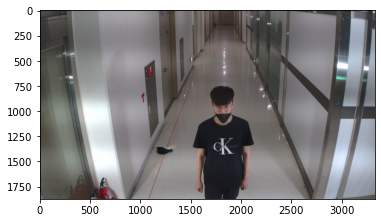

[] []


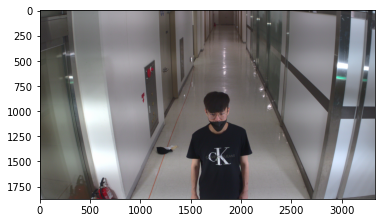

[] []


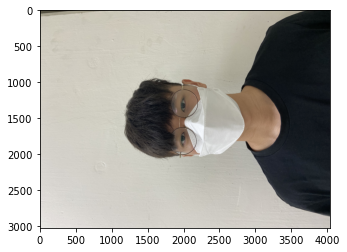

[] []


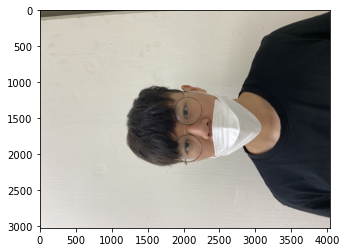

[] []


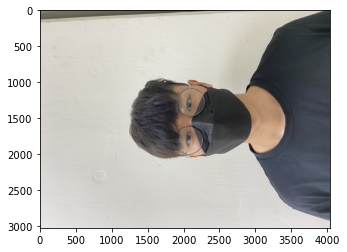

[] []


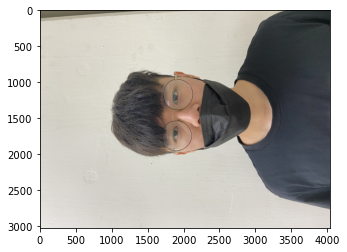

[] []


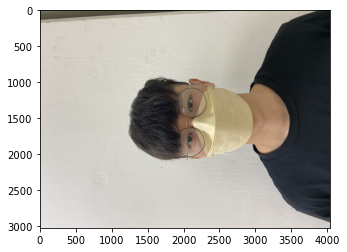

[] []


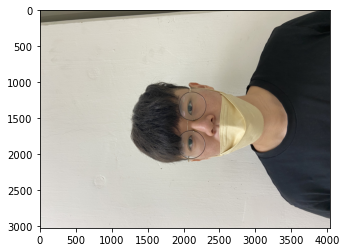

[] []


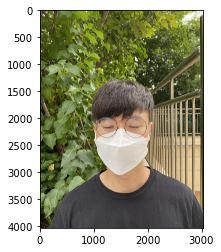

[] []


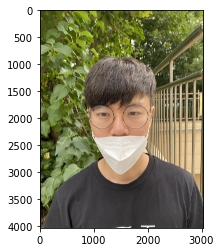

[[904, 1335, 2032, 2807]] [0.99501616]


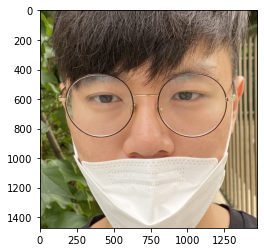

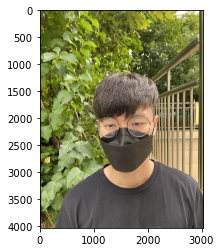

[] []


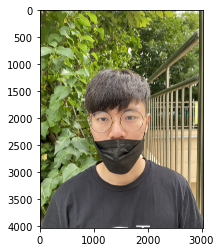

[[907, 1481, 1952, 2877]] [0.9103216]


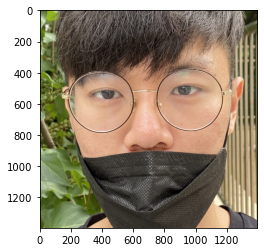

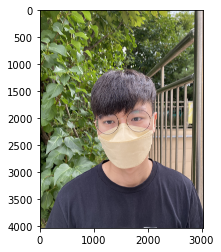

[[984, 1454, 2067, 3001]] [0.8737961]


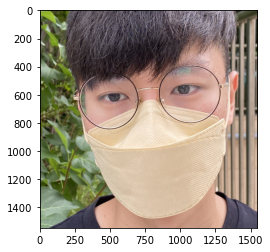

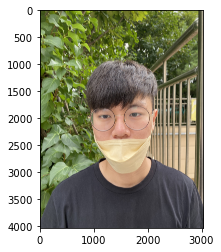

[[902, 1422, 2091, 2776]] [0.98849595]


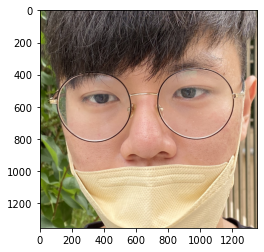

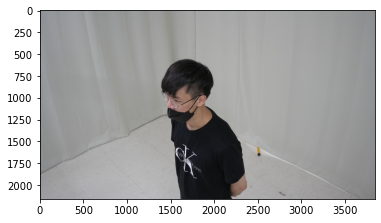

[] []


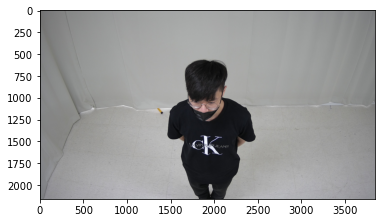

[] []


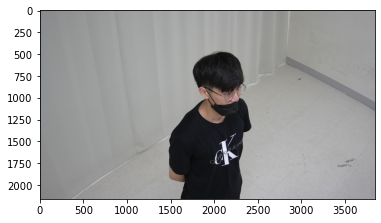

[] []


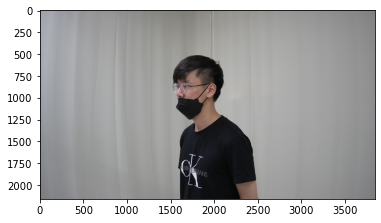

[] []


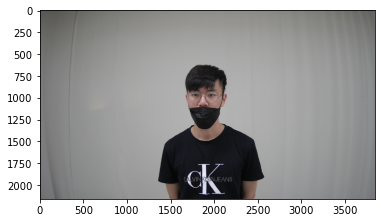

[] []


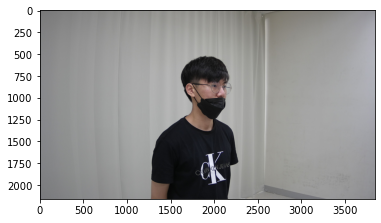

[] []


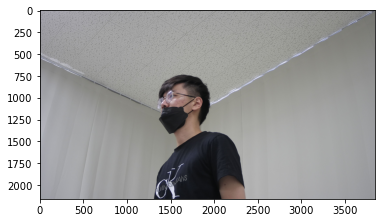

[] []


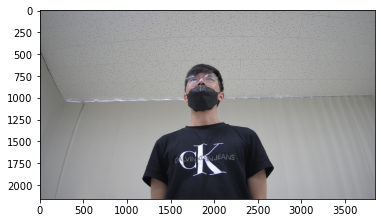

[] []


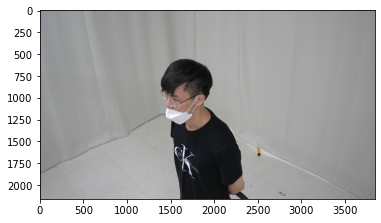

[] []


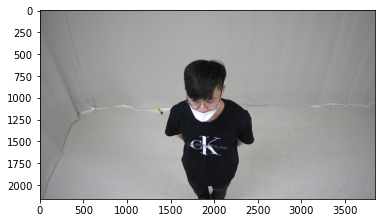

[] []


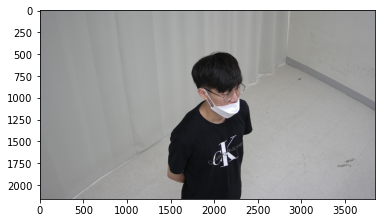

[] []


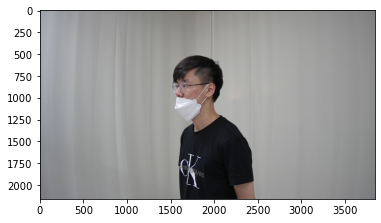

[] []


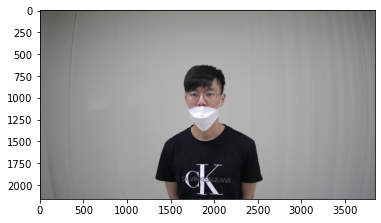

[[1656, 731, 2088, 1272]] [0.8470178]


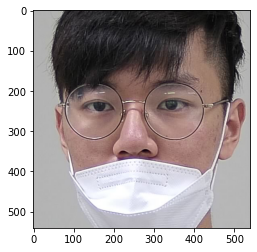

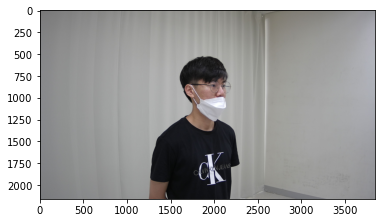

[] []


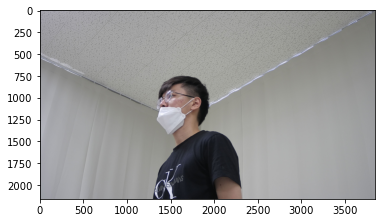

[] []


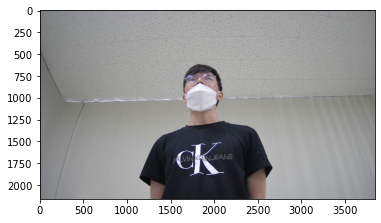

[] []


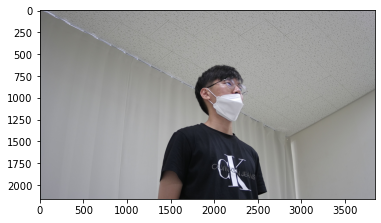

[] []


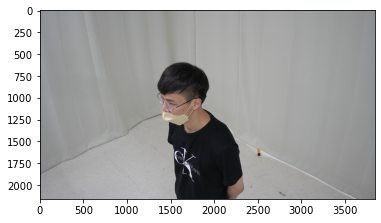

[] []


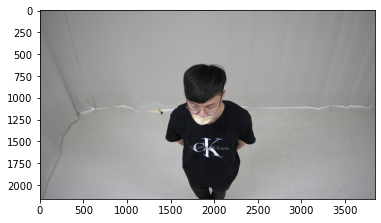

[] []


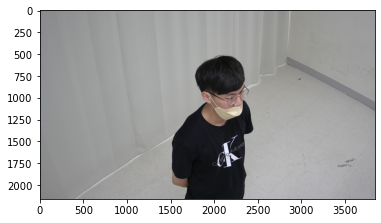

[] []


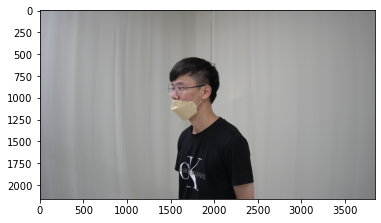

[[1526, 687, 1942, 1221]] [0.7517479]


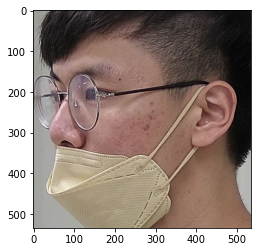

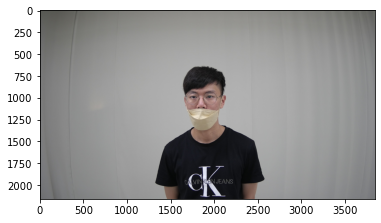

[[1665, 768, 2071, 1302]] [0.919456]


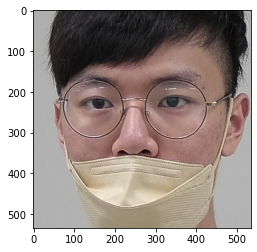

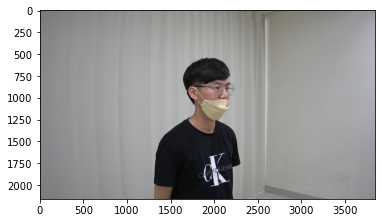

[[1821, 693, 2213, 1195]] [0.6577835]


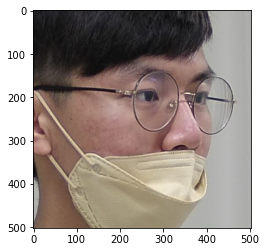

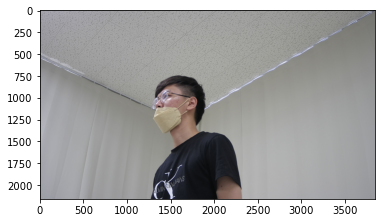

[] []


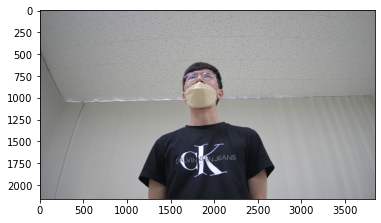

[] []


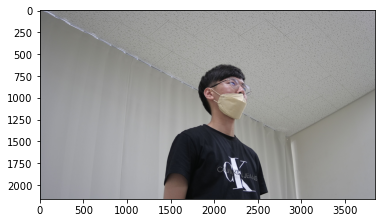

[] []


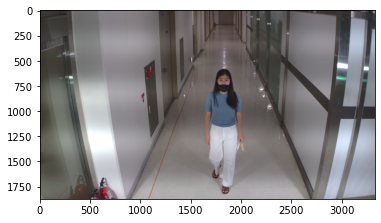

[] []


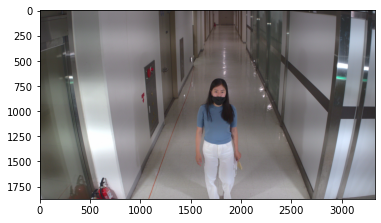

[] []


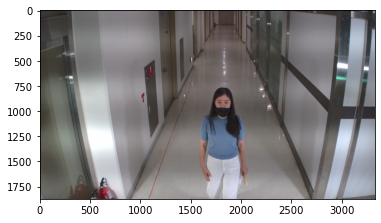

[] []


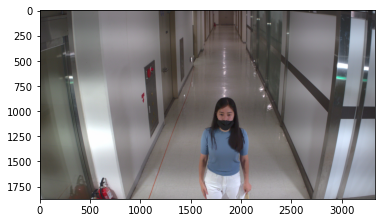

[] []


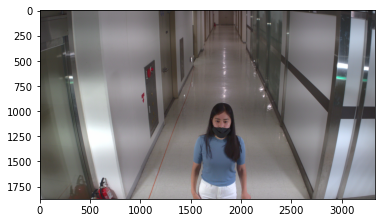

[] []


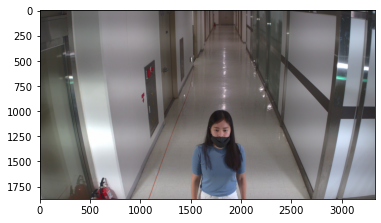

[] []


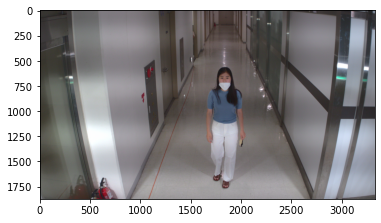

[] []


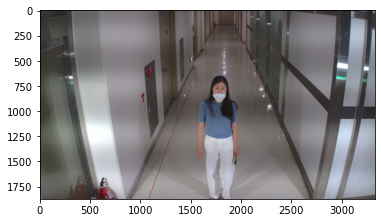

[] []


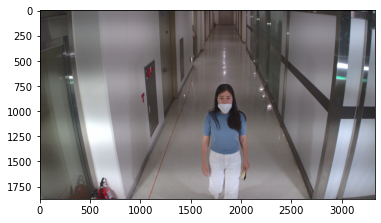

[] []


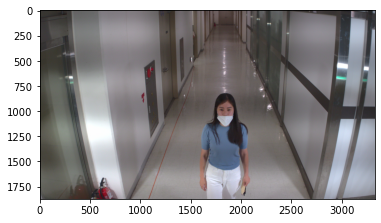

[] []


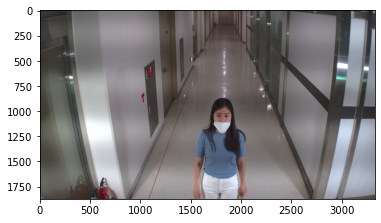

[] []


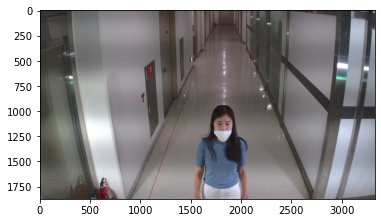

[[1714, 1002, 1925, 1285]] [0.6806692]


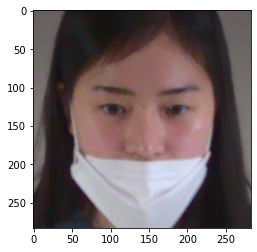

In [33]:
save_facefile(file_list_png_mask, './in_mask/', './photo_in_mask/')

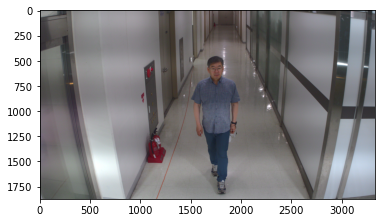

[] []


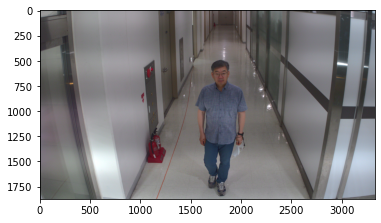

[] []


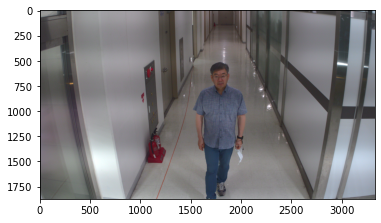

[] []


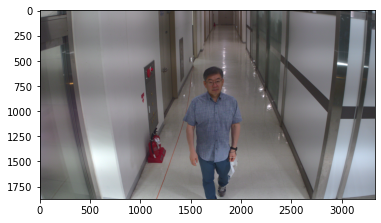

[] []


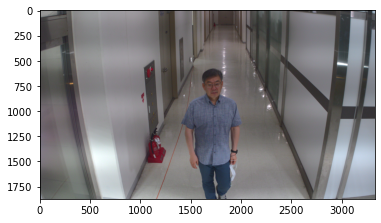

[] []


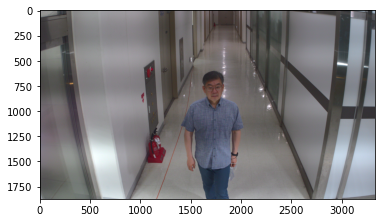

[] []


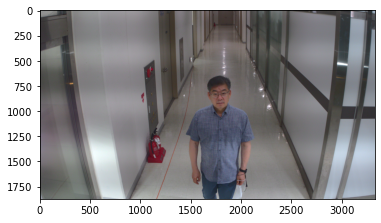

[] []


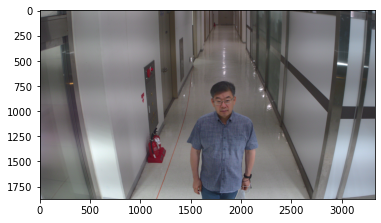

[[1723, 789, 1934, 1060]] [0.7899255]


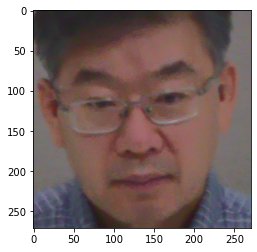

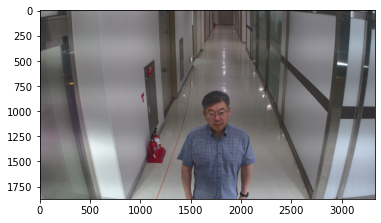

[[1646, 905, 1877, 1196]] [0.6221759]


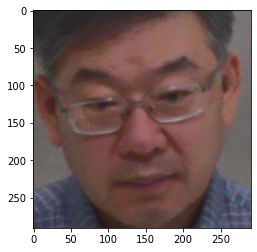

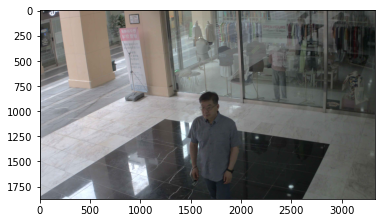

[] []


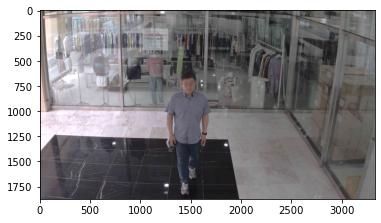

[] []


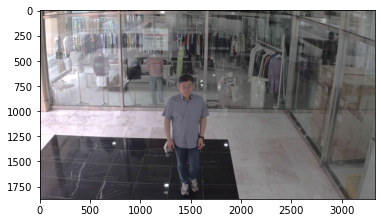

[] []


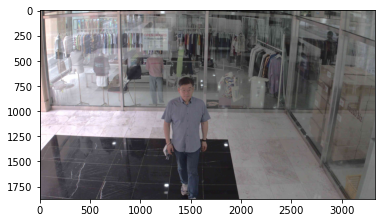

[] []


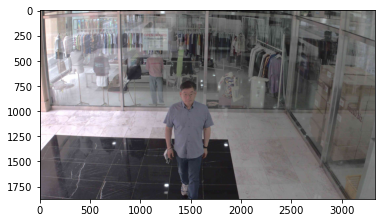

[] []


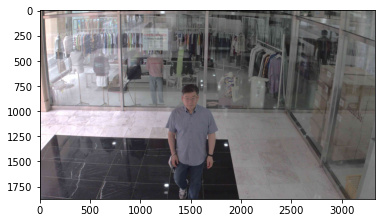

[] []


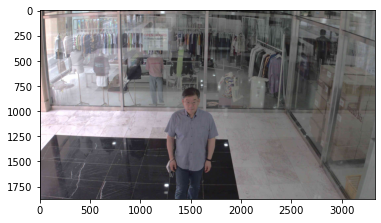

[] []


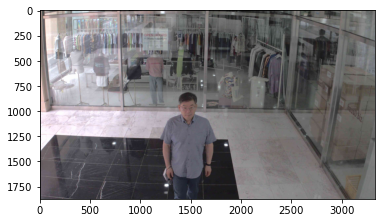

[] []


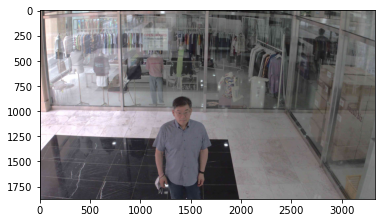

[] []


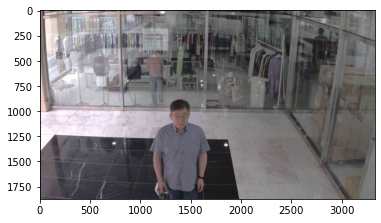

[] []


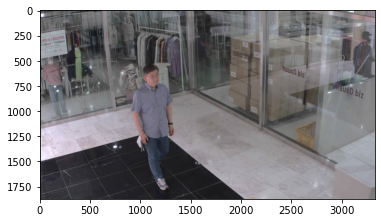

[] []


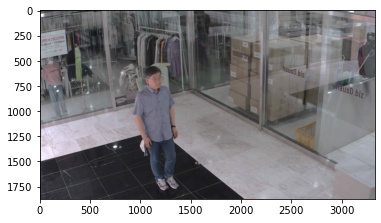

[] []


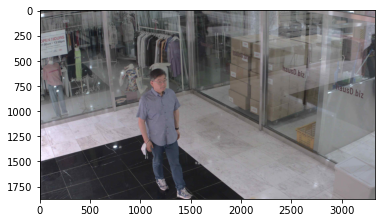

[] []


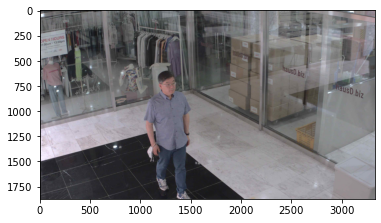

[] []


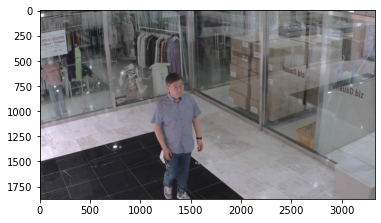

[] []


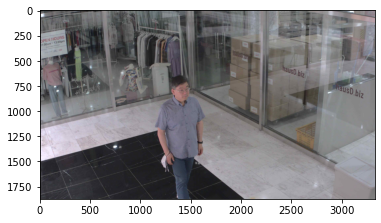

[] []


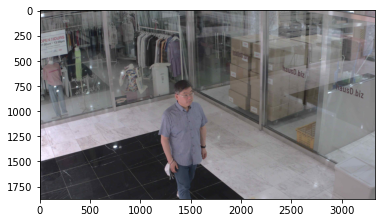

[] []


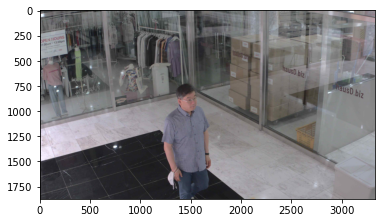

[] []


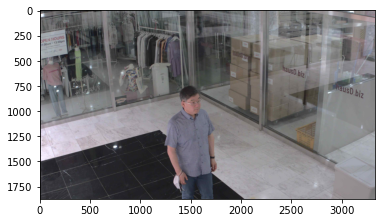

[] []


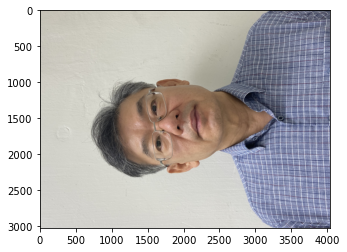

[] []


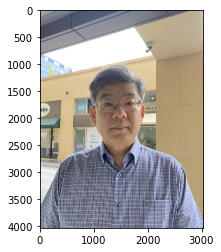

[[1013, 1296, 1861, 2532]] [0.9996917]


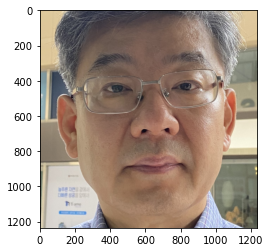

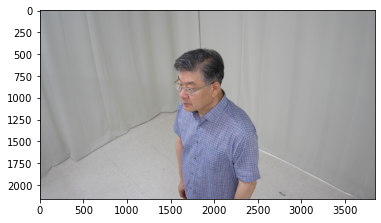

[] []


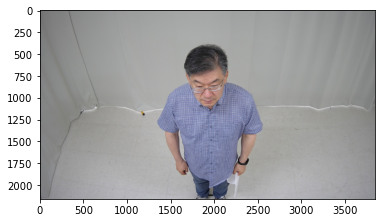

[] []


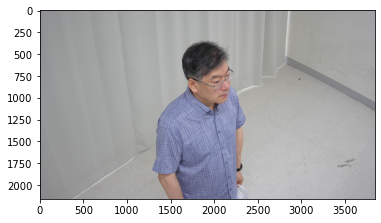

[] []


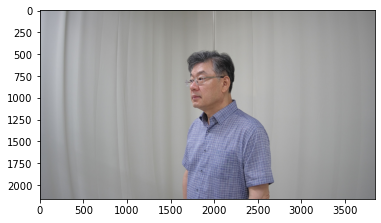

[[1697, 596, 2109, 1120]] [0.8525078]


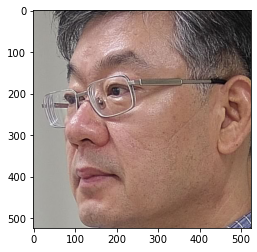

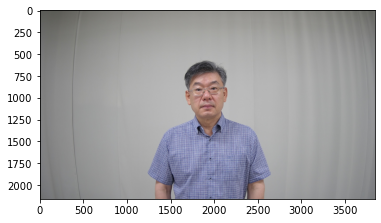

[[1697, 703, 2104, 1245]] [0.98136365]


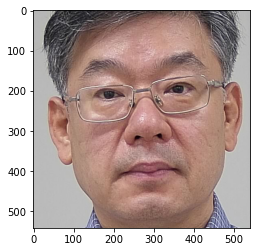

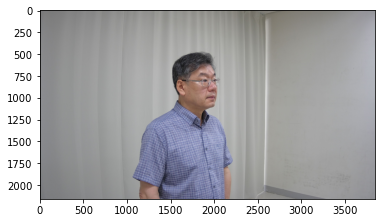

[[1666, 594, 2040, 1133]] [0.7061793]


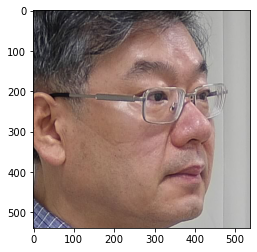

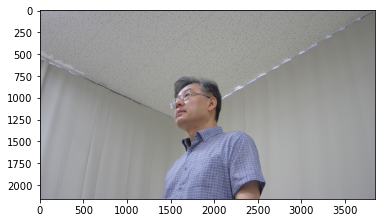

[[1525, 828, 1962, 1306]] [0.6142362]


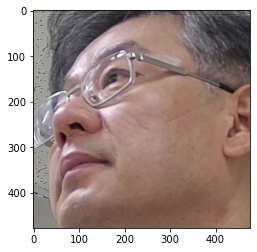

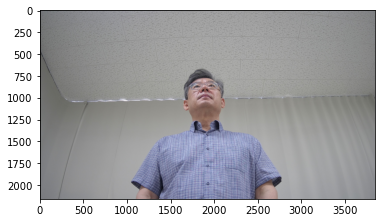

[] []


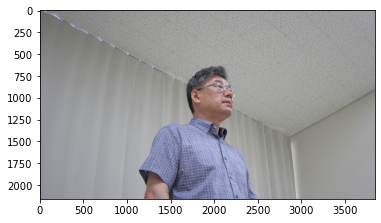

[] []


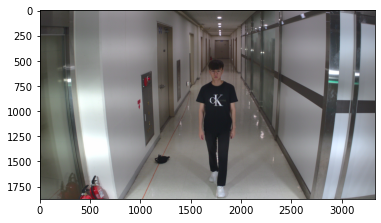

[] []


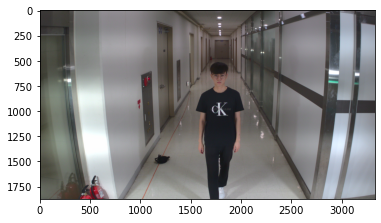

[] []


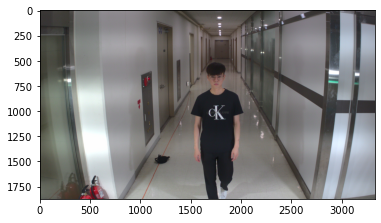

[] []


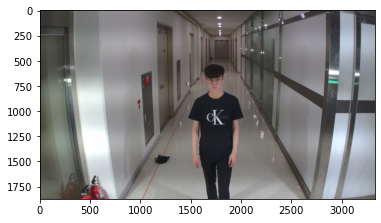

[] []


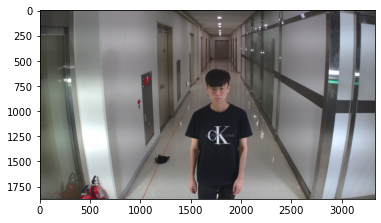

[] []


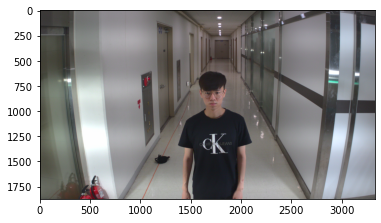

[] []


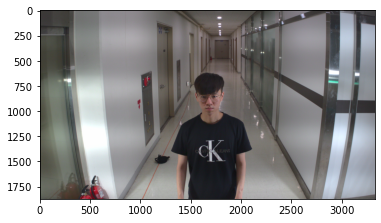

[] []


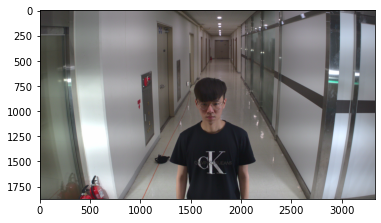

[] []


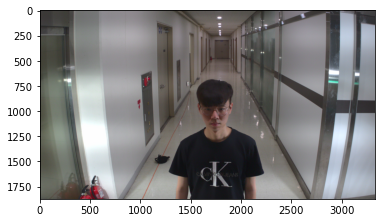

[] []


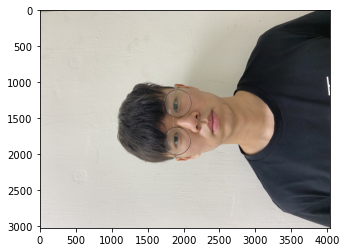

[] []


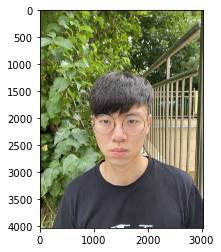

[[976, 1573, 1979, 2868]] [0.99319226]


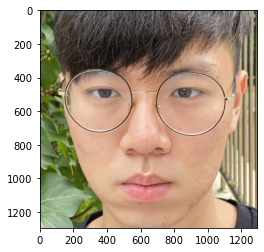

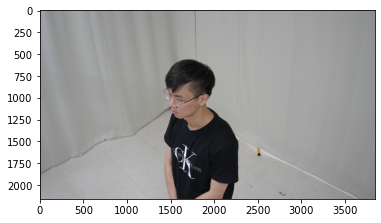

[] []


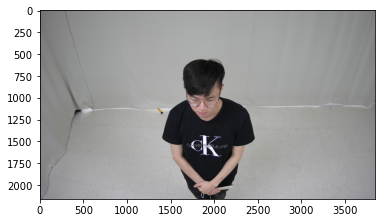

[] []


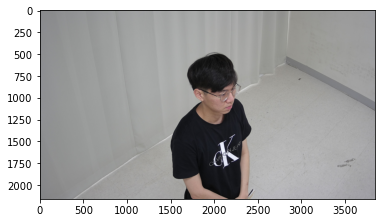

[] []


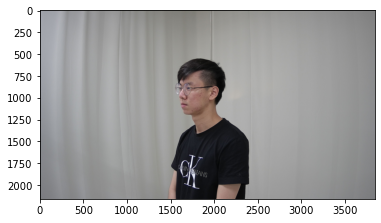

[[1587, 676, 1984, 1207]] [0.6929192]


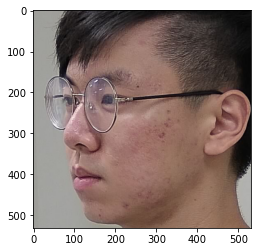

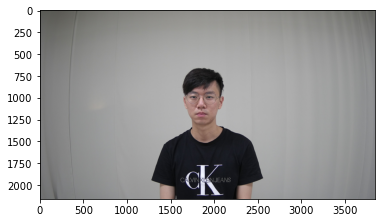

[[1675, 780, 2066, 1307]] [0.8834943]


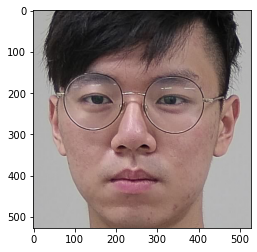

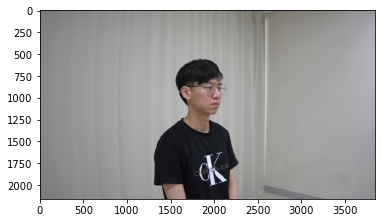

[[1710, 687, 2084, 1194]] [0.8558771]


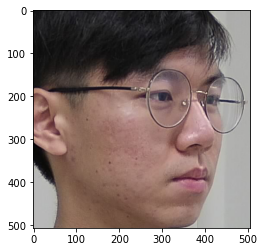

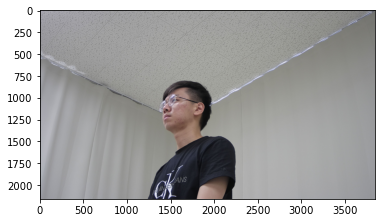

[[1362, 873, 1823, 1362]] [0.7432316]


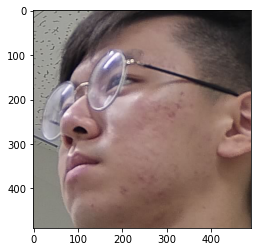

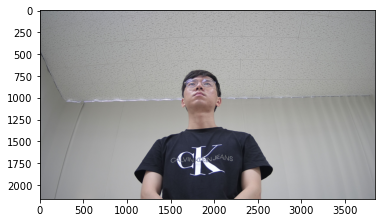

[[1670, 738, 2041, 1136]] [0.60504913]


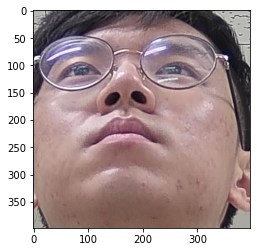

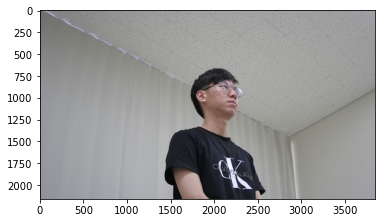

[] []


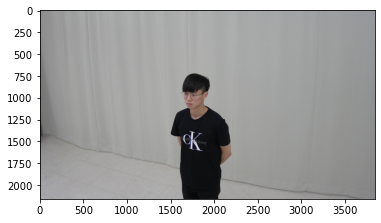

[] []


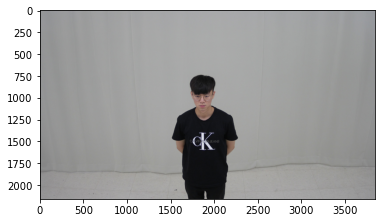

[] []


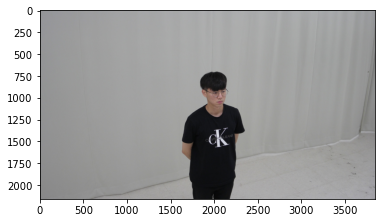

[] []


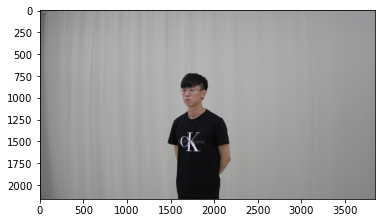

[[1637, 812, 1873, 1110]] [0.7155722]


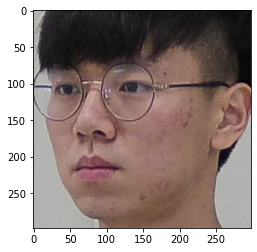

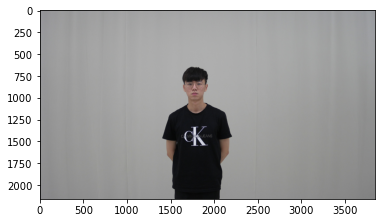

[[1652, 741, 1897, 1061]] [0.86022776]


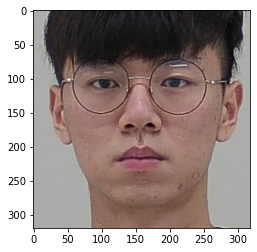

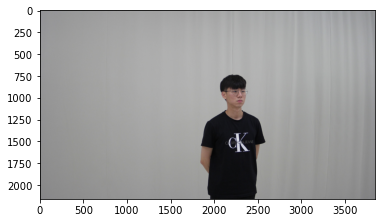

[[2107, 828, 2359, 1137]] [0.6639056]


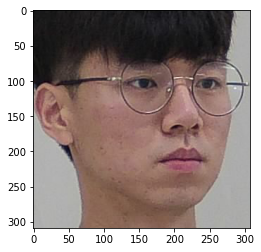

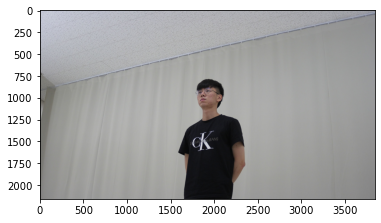

[[1800, 846, 2040, 1121]] [0.90419203]


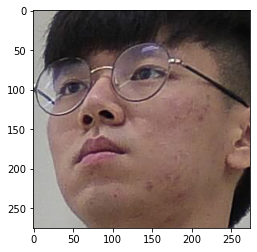

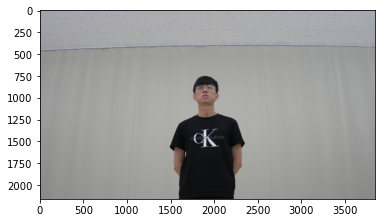

[[1780, 815, 2026, 1072]] [0.5620162]


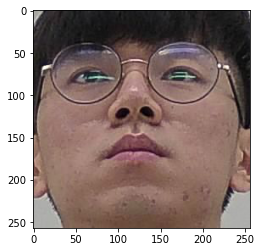

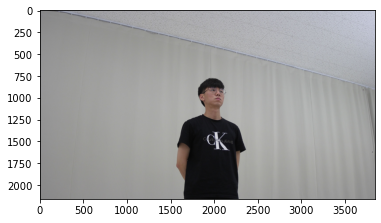

[[1878, 858, 2097, 1104]] [0.75109905]


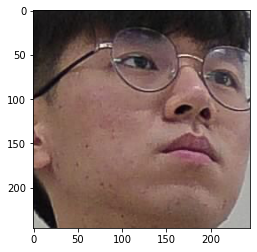

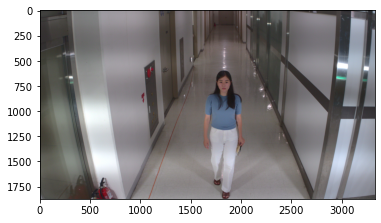

[] []


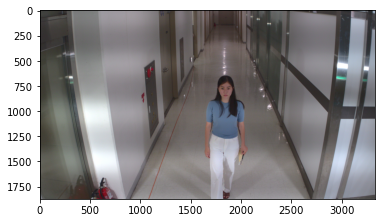

[] []


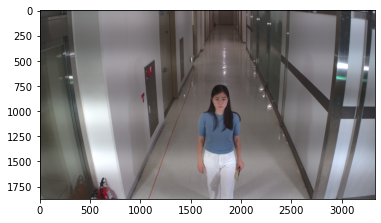

[] []


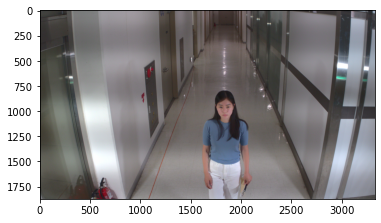

[] []


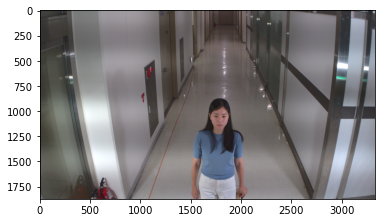

[] []


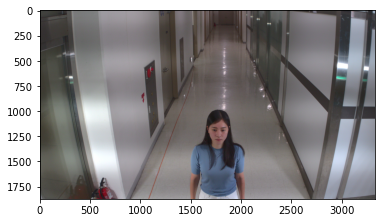

[[1675, 1088, 1871, 1329]] [0.61529666]


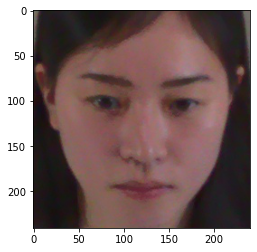

In [34]:
save_facefile(file_list_png_nonmask, './out_mask/', './photo_out_mask/')

In [35]:
import os

# 마스크 쓴 파일 목록 
path = "./in_mask/"
file_list_png_mask = os.listdir(path)
file_list_png_mask = [file for file in file_list_png_mask if file.endswith(".jpg")]
print('in mask 이미지 파일 목록: {0}'.format(file_list_png_mask))
print('in mask 이미지 개수: {0}개'.format(len(file_list_png_mask)))

in mask 이미지 파일 목록: ['0.jpg', '1.jpg', '10.jpg', '11.jpg', '12.jpg', '13.jpg', '14.jpg', '15.jpg', '16.jpg', '17.jpg', '18.jpg', '19.jpg', '2.jpg', '20.jpg', '3.jpg', '4.jpg', '5.jpg', '6.jpg', '7.jpg', '8.jpg', '9.jpg']
in mask 이미지 개수: 21개


In [36]:
import os

# 마스크 안쓴 파일 목록 
path = "./out_mask/"
file_list_png_nonmask = os.listdir(path)
file_list_png_nonmask = [file for file in file_list_png_nonmask if file.endswith(".jpg")]
print('out mask 이미지 파일 목록: {0}'.format(file_list_png_nonmask))
print('out mask 이미지 개수: {0}개'.format(len(file_list_png_nonmask)))

out mask 이미지 파일 목록: ['0.jpg', '1.jpg', '10.jpg', '11.jpg', '12.jpg', '13.jpg', '14.jpg', '15.jpg', '16.jpg', '17.jpg', '18.jpg', '19.jpg', '2.jpg', '3.jpg', '4.jpg', '5.jpg', '6.jpg', '7.jpg', '8.jpg', '9.jpg']
out mask 이미지 개수: 20개


In [37]:
non_mask_list = os.listdir('./out_mask/')
non_mask_list = [file for file in non_mask_list if file.endswith(".jpg")]
mask_list = os.listdir('./in_mask/')
mask_list = [file for file in mask_list if file.endswith(".jpg")]

In [39]:
widths = []
heights = []

for non_mask in non_mask_list:
    image = cv2.imread("./out_mask/" + non_mask)
    widths.append(image.shape[1])
    heights.append(image.shape[0])
    
for mask in mask_list:
    image = cv2.imread("./in_mask/" + mask)
    widths.append(image.shape[1])
    heights.append(image.shape[0])

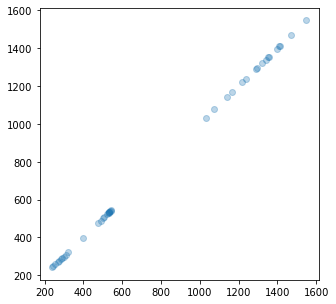

In [40]:
plt.figure(figsize=(5, 5))
plt.scatter(widths, heights, alpha=0.3)

<ipython-input-41-d4867809ea09>:7: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


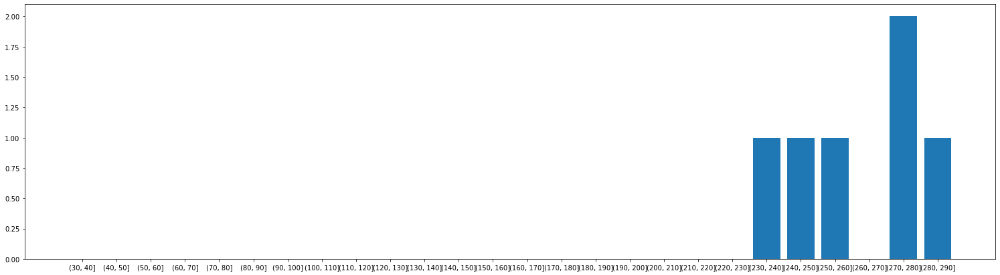

In [41]:
cut_widths = pd.cut(widths, np.arange(30, 300, 10)).value_counts()

fig, ax = plt.subplots(figsize=(26, 7))
ax.bar(range(len(cut_widths)),cut_widths.values)
ax.set_xticks(range(len(cut_widths)))
ax.set_xticklabels(cut_widths.index)
fig.show()

<ipython-input-42-f42610c7dce6>:7: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


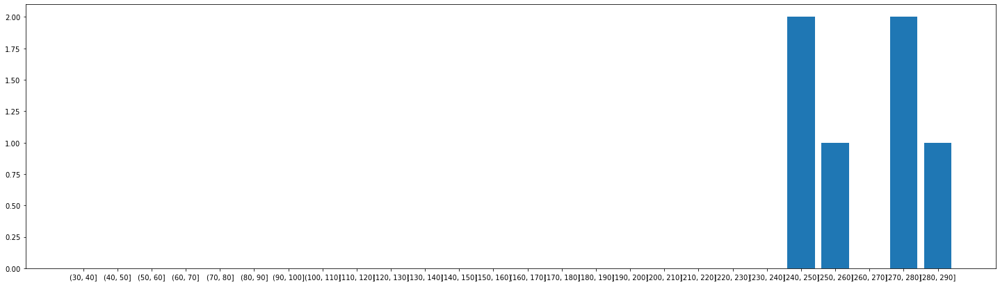

In [42]:
cut_heights = pd.cut(heights, np.arange(30, 300, 10)).value_counts()

fig, ax = plt.subplots(figsize=(25,7))
ax.bar(range(len(cut_heights)),cut_heights.values)
ax.set_xticks(range(len(cut_heights)))
ax.set_xticklabels(cut_heights.index)
fig.show()

In [43]:
image_height = 280
image_width = 280

images = []
labels = []

for non_mask in non_mask_list:
    image = load_img('./out_mask/'+non_mask, target_size=(image_height, image_width))
    image = img_to_array(image)
    images.append(image)
    labels.append(0)
    
for mask in mask_list:
    image = load_img('./in_mask/'+mask, target_size=(image_height, image_width))
    image = img_to_array(image)
    images.append(image)
    labels.append(1)

In [45]:
from sklearn.model_selection import train_test_split
import numpy as np

X = np.array(images) / 255. # 255 로 나누어주어 0~1 사이의 값으로 만들어줍니다.
y = np.array(labels) 
x_train, x_valid_test, y_train, y_valid_test = train_test_split(X, y, test_size=0.4, shuffle = True, random_state = 0)
x_val, x_test, y_val, y_test = train_test_split(x_valid_test, y_valid_test, test_size=0.5, shuffle = True, random_state = 0)
print('훈련용 데이터 개수:', len(x_train))
print('검증용 데이터 개수:', len(x_val))
print('테스트용 데이터 개수:', len(x_test))

훈련용 데이터 개수: 24
검증용 데이터 개수: 8
테스트용 데이터 개수: 9


In [47]:
image_channel = 3
model = Sequential([    
    Conv2D(filters=16, kernel_size=(3,3), activation='relu', input_shape=(image_height, image_width, image_channel)),
    MaxPool2D(pool_size=(2, 2)),
    Dropout(rate=0.25),
    
    Conv2D(filters=32, kernel_size=(3,3), activation='relu'),
    MaxPool2D(pool_size=(2, 2)),
    Dropout(rate=0.25),
    
    Flatten(),
    Dense(64, activation='relu'),
    Dropout(rate=0.25),
    Dense(2, activation='softmax')
])

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 278, 278, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 139, 139, 16)      0         
_________________________________________________________________
dropout (Dropout)            (None, 139, 139, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 137, 137, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 68, 68, 32)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 68, 68, 32)        0         
_________________________________________________________________
flatten (Flatten)            (None, 147968)            0

In [48]:
model.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=Adam(learning_rate=1e-3),
    metrics=['accuracy']
)

In [49]:
EPOCHS = 10

history = model.fit(x_train, 
                    y_train,
                    validation_data = (x_val, y_val),
                    epochs=EPOCHS, 
                   )

Epoch 1/10
1/1 [==============================] - 1s 515ms/step - loss: 0.7145 - accuracy: 0.5417 - val_loss: 16.2182 - val_accuracy: 0.5000
Epoch 2/10
1/1 [==============================] - 0s 124ms/step - loss: 22.7574 - accuracy: 0.5833 - val_loss: 6.7829 - val_accuracy: 0.5000
Epoch 3/10
1/1 [==============================] - 0s 130ms/step - loss: 10.8209 - accuracy: 0.4583 - val_loss: 1.7941 - val_accuracy: 0.6250
Epoch 4/10
1/1 [==============================] - 0s 113ms/step - loss: 1.6709 - accuracy: 0.7083 - val_loss: 5.4194 - val_accuracy: 0.5000
Epoch 5/10
1/1 [==============================] - 0s 221ms/step - loss: 6.9292 - accuracy: 0.6250 - val_loss: 3.5464 - val_accuracy: 0.5000
Epoch 6/10
1/1 [==============================] - 0s 116ms/step - loss: 4.1913 - accuracy: 0.6667 - val_loss: 0.8932 - val_accuracy: 0.6250
Epoch 7/10
1/1 [==============================] - 0s 159ms/step - loss: 0.8297 - accuracy: 0.8333 - val_loss: 0.7335 - val_accuracy: 0.7500
Epoch 8/10
1/1 [=

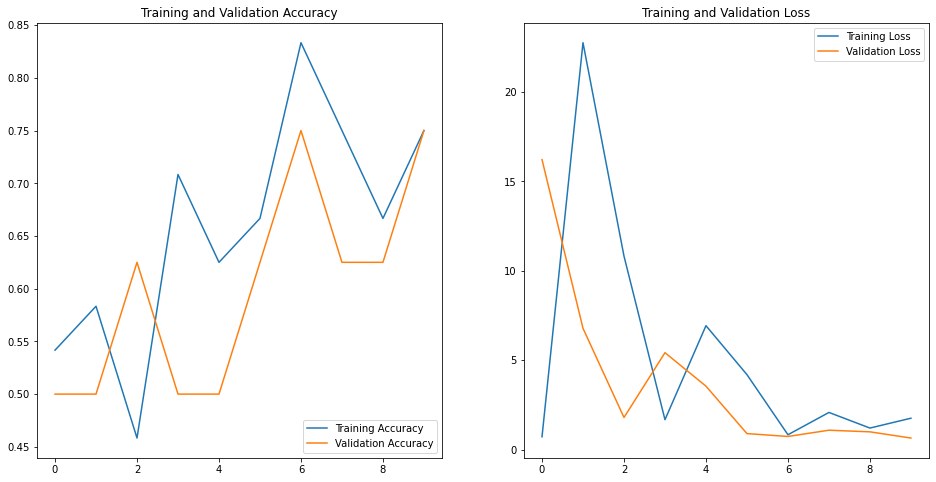

In [50]:
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

loss=history.history['loss']
val_loss=history.history['val_loss']

epochs_range = range(EPOCHS)

plt.figure(figsize=(16, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, accuracy, label='Training Accuracy')
plt.plot(epochs_range, val_accuracy, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [51]:
test_loss, test_accuracy = model.evaluate(x_test, y_test, verbose=0)

print('test set accuracy: ', test_accuracy)

test set accuracy:  0.6666666865348816


In [52]:
test_prediction = np.argmax(model.predict(x_test), axis=-1)

<AxesSubplot:>

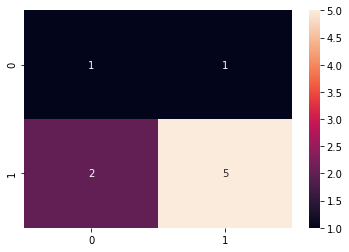

In [53]:
cm = confusion_matrix(y_test, test_prediction)
sns.heatmap(cm, annot = True)